# Speech understanding
## Introduction
This notebook is for playing with audio files. Understanding the fundamental speech frequency and other well known terms in speech signal processing like Mel-Frequency Cepstral Coefficients (MFCCs), Gammatone-Frequency Cepstral Coefficients (GFCC), Bark-Frequency Cepstral Coefficients (BFCC) and so on.
## Audio import and playing audio

In [1]:
import os
import audioread
import librosa
import numpy as np
import matplotlib.pyplot as plt
from copy import deepcopy
from librosa.display import specshow
from IPython.display import Audio as iAudio

from scipy.signal import spectrogram
from pydub import AudioSegment, effects

audio_book_path = r'./input/cienmejorespoesias_000_menendezypelayo_64kb.mp3'
noise_path = r'./input/city4_short.mp3'

class AudioManager:
    def __init__(self, path=''):
        self.path = path
        self.raw  = None
        self.norm = None
        self.ext = os.path.splitext(self.path)[1][1:]
        self.samples = None
        self.n_channels  = None
        self.sample_rate = None
        self.duration    = None
        if not self.path == '':
            self.load()
            
    def __add__(self, audio_manager):
        ret_value = deepcopy(self)
        ret_value.raw.overlay(audio_manager.raw)
        ret_value.norm = effects.normalize(ret_value.raw)
        ret_value.get_samples()
        
        return ret_value
        
    def get_samples(self):
        self.samples = np.array(self.raw.get_array_of_samples(), dtype=np.float32)
        
    def load(self):
        with audioread.audio_open(self.path) as fId:
            self.n_channels  = fId.channels
            self.sample_rate = fId.samplerate
            self.duration    = fId.duration
        self.raw = AudioSegment.from_file(self.path, self.ext)
        if self.n_channels != 1:
            print('Audio ' + self.path + ' contains more than one channel. Converting to mono')
            self.raw.set_channels(1)
        self.norm = effects.normalize(self.raw)
        self.get_samples()
        #self.samples, sr = librosa.load(self.path)
        #print('LibRosa Sampling rate '+ str(sr) + '\n' +
        #      'AudioRead Sampling rate ' + str(self.sample_rate))
        
    def player(self):
        return self.raw
    
    def plot_spectrogram(self, plot_type='log'):
        plot_types = ['log','linear']
        if not plot_type in plot_types:
            raise Exception('Unknown plot_type: Allowed ' + str(plot_types))
        fig_handler = plt.figure(figsize=(200,100), dpi= 80, facecolor='w', edgecolor='k')
        db_values = librosa.amplitude_to_db(np.abs(librosa.stft(self.samples)), ref=np.max)
        ax_handler = plt.subplot(4, 2, 1)
        specshow(db_values, y_axis=plot_type)
        plt.colorbar(format='%+2.0f dB')
        plt.title(plot_type + '-frequency power spectrogram')
        ax_handler.xaxis.label.set_size(50)
        ax_handler.yaxis.label.set_size(50)
        
        

In [2]:
# Loaing audio book
audio_book = AudioManager(audio_book_path)

# Loaing and normalizing noise audio
noise = AudioManager(noise_path)

Audio ./input/city4_short.mp3 contains more than one channel. Converting to mono


#### Players and spectrograms

In [3]:
audio_book.player()

In [4]:
noise.player()

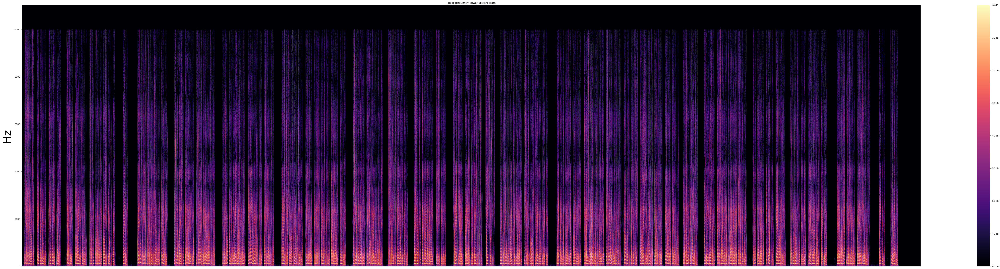

In [5]:
audio_book.plot_spectrogram('linear')

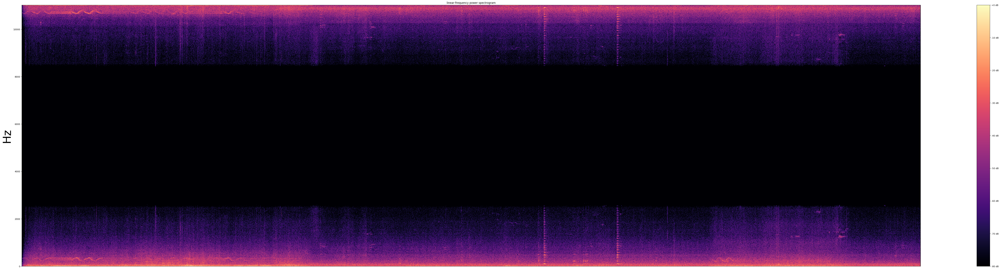

In [6]:
noise.plot_spectrogram('linear')

In [7]:
sum_audio = audio_book + noise
sum_audio.player()